In [1]:
import tensorflow as tf
import tensorflow_datasets as tfds

c:\Users\MAPCO1720\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\export\tf2onnx_lib.py:8: FutureWarning: In the future `np.object` will be defined as the corresponding NumPy scalar.
  if not hasattr(np, "object"):


In [ ]:
datos, metadatos = tfds.load("mnist", as_supervised=True, with_info=True)

In [ ]:
metadatos

In [ ]:
datos_entrenamiento = datos["train"]
datos_pruebas = datos["test"]

In [ ]:
nombre_clases = metadatos.features["label"].names

In [ ]:
#Normalizacion
#0-255 1 byte
#Transformar 0-255 0-1 (0=0, 127=.5, 255=1)
#Normalizar datos enteros y pruebas con una funcion
def Normalizar(imagenes, etiquetas):
    imagenes = tf.cast(imagenes, tf.float32) 
    imagenes = imagenes / 255
    return imagenes, etiquetas


datos_entrenamiento = datos_entrenamiento.map(Normalizar)
datos_pruebas = datos_pruebas.map(Normalizar)

#Guardarlo en el cache
datos_entrenamiento = datos_entrenamiento.cache()
datos_pruebas = datos_pruebas.cache()

In [ ]:
for imagenes,etiquetas in datos_entrenamiento.take(1):
    break

import matplotlib.pyplot as plt
#Mostraremos en la pantalla
plt.figure()
plt.imshow(imagenes,cmap=plt.cm.binary)
plt.colorbar()
plt.show()

In [ ]:
plt.figure(figsize=(10,10))
for  i,(imagenes,etiquetas) in enumerate(datos_entrenamiento.take(25)):
    plt.subplot(5,5,i+1)
    plt.imshow(imagenes,cmap=plt.cm.binary)



#Mostraremos en la pantalla

plt.show()




In [ ]:
# modelo = tf.keras.Sequential([
#     #784 datos de entrada em vez de las 25 imagenes
#     tf.keras.layers.Flatten(input_shape=(28,28,1)), #1 = blanco y negro
#     #Cualquier capa que siga de la inicial se le llama 
#     #capa oculta
#     tf.keras.layers.Dense(1),
#     #Capa de salida
#     tf.keras.layers.Dense(10,activation=tf.nn.softmax)
# ])
modelo = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32,(3,3), input_shape=(28,28,1), activation="relu"), 
    #Especifica cuantos filtros y el tamaño
    tf.keras.layers.MaxPooling2D(2,2),
#Agruparlo con una imagen mas pequeña con MaxPooling

    tf.keras.layers.Conv2D(64,(3,3),  activation="relu"),
    tf.keras.layers.MaxPooling2D(2,2),

    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(units=100, activation="relu"),
    #Ayuda a que el modelo tenga mas parametros ajustables
    tf.keras.layers.Dense(10,activation="softmax")   
])

In [ ]:
modelo.compile(
    optimizer="adam",
    loss=tf.keras.losses.SparseCategoricalCrossentropy(),
    metrics=["accuracy"]
)


In [ ]:
TAMANO_LOTE = 32
datos_entrenamiento = datos_entrenamiento.shuffle(60000).batch(TAMANO_LOTE).repeat()
datos_pruebas = datos_pruebas.batch(TAMANO_LOTE)

In [ ]:
import math
#Entrenar
entrenamiento = modelo.fit(
    datos_entrenamiento, epochs=10,
    steps_per_epoch=math.ceil(60000/TAMANO_LOTE)
)

In [ ]:
#Pintar un cuadro con sus respectivas predicciones
#Y marcar si fue correcta (Azul) o incorrecta (roja)
import numpy as np
for imagenes_Pruebaxd, etiquetas_pruebaxd in datos_pruebas.take(1):
    imagenes_Pruebaxd = imagenes_Pruebaxd.numpy()
    etiquetas_pruebaxd = etiquetas_pruebaxd.numpy()
    predicciones = modelo.predict(imagenes_Pruebaxd)
def graficar_imagen(i,arr_predicciones,etiquetas_reales, imagenes):
    arr_predicciones, etiquetas_reales, img= arr_predicciones[i], etiquetas_reales[i], imagenes[i]
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])

    plt.imshow(img[...,0], cmap=plt.cm.binary)
    etiqueta_prediccion= np.argmax(arr_predicciones)
    if etiqueta_prediccion == etiquetas_reales:
        color = 'blue'
    else:
        color = 'red'
    plt.xlabel("{} {:2.0f}% ({})".format(nombre_clases[etiqueta_prediccion],
                                         100*np.max(arr_predicciones),
                                         nombre_clases[etiquetas_reales]),
                                         color=color)

def graficar_valor_arreglo(i,arr_predicciones,etiqueta_real):
    arr_predicciones,etiqueta_real = arr_predicciones[i], etiqueta_real[i]
    plt.grid(False)
    plt.xticks([])
    plt.yticks([])
    grafica= plt.bar(range(10), arr_predicciones, color="#777777")
    plt.ylim([0,1])
    etiqueta_prediccion= np.argmax(arr_predicciones)
    grafica[etiqueta_prediccion].set_color('red')
    grafica[etiqueta_real].set_color('blue')

filas = 5
columnas = 5
num_imagenes = filas * columnas
plt.figure(figsize=(2*2*columnas, 2*filas))
for i in range(num_imagenes):
    plt.subplot(filas,2*columnas, 2*i+1)
    graficar_imagen(i,predicciones,etiquetas_pruebaxd,imagenes_Pruebaxd)
    plt.subplot(filas, 2*columnas, 2*i+2)
    graficar_valor_arreglo(i,predicciones,etiquetas_pruebaxd)

In [2]:
import os
print(os.getcwd())

c:\Users\MAPCO1720\Downloads\Red_Neuronal_Convulucional


In [3]:
from pathlib import Path
ruta = Path(r"C:\Users\MAPCO1720\Desktop\Imagen\PetImages")
print(ruta.exists())
print(os.listdir(ruta))
print(list(ruta.iterdir()))

True
['Cat', 'Dog']
[WindowsPath('C:/Users/MAPCO1720/Desktop/Imagen/PetImages/Cat'), WindowsPath('C:/Users/MAPCO1720/Desktop/Imagen/PetImages/Dog')]


In [4]:
from PIL import Image
from pathlib import Path

imagenes_borradas = 0

for carpeta in ["Cat", "Dog"]:
    subruta = ruta / carpeta
    print(subruta)
   
    for img_path in subruta.iterdir():
        if img_path.suffix.lower() not in [".jpg", ".jpeg", ".png"]:
            img_path.unlink()
            continue
        try:
            with Image.open(img_path) as img:
                img.verify()
        except:
            img_path.unlink()
            imagenes_borradas += 1

print("Imágenes corruptas eliminadas:", imagenes_borradas)


C:\Users\MAPCO1720\Desktop\Imagen\PetImages\Cat
C:\Users\MAPCO1720\Desktop\Imagen\PetImages\Dog


c:\Users\MAPCO1720\AppData\Local\Programs\Python\Python312\Lib\site-packages\PIL\TiffImagePlugin.py:949: UserWarning: Truncated File Read
  warnings.warn(str(msg))


Imágenes corruptas eliminadas: 0


In [5]:
import os
from pathlib import Path
from PIL import Image

# Define la ruta base
ruta = Path(r"C:\Users\MAPCO1720\Desktop\Imagen\PetImages")
print("Ruta válida:", ruta.exists())

# Imprimir contenido del directorio base
print("Contenido del directorio:", os.listdir(ruta))

imagenes_borradas = 0

# Iterar sobre las carpetas "Cat" y "Dog"
for carpeta in ["Cat", "Dog"]:
    subruta = ruta / carpeta
    print(f"Procesando carpeta: {subruta}")
    
    # Verificar si la carpeta existe
    if not subruta.exists():
        print(f"¡Advertencia! La carpeta {subruta} no existe. Se omite.")
        continue  # Si la carpeta no existe, continuar con la siguiente

    for img_path in subruta.iterdir():
        # Verificar si el archivo tiene una extensión válida
        if img_path.suffix.lower() not in [".jpg", ".jpeg", ".png"]:
            print(f"Eliminando archivo no válido: {img_path}")
            img_path.unlink()
            continue
        
        # Intentar abrir y verificar la imagen
        try:
            with Image.open(img_path) as img:
                img.verify()  # Verificación rápida de la imagen
        except (IOError, SyntaxError) as e:
            print(f"Imagen corrupta eliminada: {img_path}, Error: {e}")
            img_path.unlink()
            imagenes_borradas += 1

# Imprimir la cantidad de imágenes corruptas eliminadas
print(f"Imágenes corruptas eliminadas: {imagenes_borradas}")


Ruta válida: True
Contenido del directorio: ['Cat', 'Dog']
Procesando carpeta: C:\Users\MAPCO1720\Desktop\Imagen\PetImages\Cat
Procesando carpeta: C:\Users\MAPCO1720\Desktop\Imagen\PetImages\Dog
Imágenes corruptas eliminadas: 0


In [6]:
datos = tf.keras.utils.image_dataset_from_directory(
    ruta,
    image_size=(224, 224),
    batch_size=32,
    color_mode="rgb"
)


datos = datos.apply(tf.data.experimental.ignore_errors())


Found 24997 files belonging to 2 classes.
Instructions for updating:
Use `tf.data.Dataset.ignore_errors` instead.


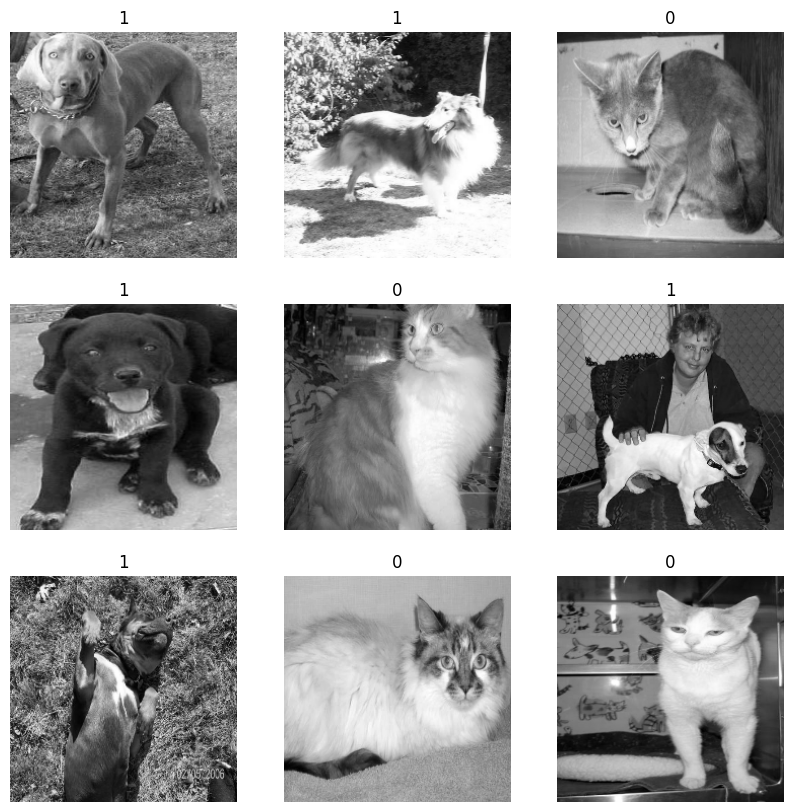

In [7]:
import matplotlib.pyplot as plt
import cv2
plt.figure(figsize=(10,10))
for imagenes, etiquetas in datos.take(1):
    for i in range(9):
        imagen_gris = cv2.cvtColor(imagenes[i].numpy().astype("uint8"), cv2.COLOR_BGR2GRAY)
        plt.subplot(3,3,i+1)
    
        plt.imshow(imagen_gris, cmap="gray")
        plt.title(etiquetas[i].numpy())
        plt.axis("off")

plt.show()

In [8]:
datos_entrenamiento_nuevo = []

In [9]:
# for imagenes, etiquetas in datos:
#  for i in range(imagenes.shape[0]):
  
#   img = imagenes[i].numpy().astype("uint8")
#   imagen_gris = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
#   datos_entrenamiento_nuevo.append((imagen_gris, etiquetas[i].numpy()))
  

# print(datos_entrenamiento_nuevo)

In [10]:
def a_gris(imagen, etiqueta):
    imagen = tf.image.rgb_to_grayscale(imagen)
    return imagen, etiqueta

datos_gris = datos.map(a_gris)



In [11]:
for img, label in datos_gris.unbatch():
    datos_entrenamiento_nuevo.append((img, label))
print(datos_entrenamiento_nuevo)

[(<tf.Tensor: shape=(224, 224, 1), dtype=float32, numpy=
array([[[ 32.66526 ],
        [ 32.256386],
        [ 34.16214 ],
        ...,
        [ 58.322853],
        [ 60.22629 ],
        [ 56.668926]],

       [[ 31.96283 ],
        [ 28.902681],
        [ 27.795782],
        ...,
        [ 53.951973],
        [ 58.754444],
        [ 54.061485]],

       [[ 27.154503],
        [ 28.882053],
        [ 26.179821],
        ...,
        [ 51.166454],
        [ 55.77177 ],
        [ 52.89806 ]],

       ...,

       [[ 77.14982 ],
        [ 77.97206 ],
        [ 75.77776 ],
        ...,
        [ 98.92699 ],
        [130.39473 ],
        [ 86.4882  ]],

       [[ 77.43297 ],
        [ 77.23053 ],
        [ 74.55556 ],
        ...,
        [126.38893 ],
        [ 86.57646 ],
        [117.239746]],

       [[ 77.64001 ],
        [ 74.50484 ],
        [ 71.3324  ],
        ...,
        [131.7729  ],
        [104.47582 ],
        [ 98.303856]]], shape=(224, 224, 1), dtype=float32)>, <tf.Tensor

In [12]:
datos_entrenamiento_nuevo[0]

(<tf.Tensor: shape=(224, 224, 1), dtype=float32, numpy=
 array([[[ 32.66526 ],
         [ 32.256386],
         [ 34.16214 ],
         ...,
         [ 58.322853],
         [ 60.22629 ],
         [ 56.668926]],
 
        [[ 31.96283 ],
         [ 28.902681],
         [ 27.795782],
         ...,
         [ 53.951973],
         [ 58.754444],
         [ 54.061485]],
 
        [[ 27.154503],
         [ 28.882053],
         [ 26.179821],
         ...,
         [ 51.166454],
         [ 55.77177 ],
         [ 52.89806 ]],
 
        ...,
 
        [[ 77.14982 ],
         [ 77.97206 ],
         [ 75.77776 ],
         ...,
         [ 98.92699 ],
         [130.39473 ],
         [ 86.4882  ]],
 
        [[ 77.43297 ],
         [ 77.23053 ],
         [ 74.55556 ],
         ...,
         [126.38893 ],
         [ 86.57646 ],
         [117.239746]],
 
        [[ 77.64001 ],
         [ 74.50484 ],
         [ 71.3324  ],
         ...,
         [131.7729  ],
         [104.47582 ],
         [ 98.303856]]], 

In [13]:
#Preparacion de datos para entrenamiento
X = [] # Características (imágenes en escala de grises)
y = [] # Etiquetas (clases correspondientes)
for imagen, etiqueta in datos_entrenamiento_nuevo:
 X.append(imagen)
 y.append(etiqueta)


In [14]:
# #Normalizar los datos
# import numpy as np
# X = np.array(X).astype(float) / 255
# y = np.array(y)
def Normalize(imagen, etiqueta):
    imagen = tf.cast(imagen, tf.float32) / 255.0
    return imagen, etiqueta

datos_gris = datos_gris.map(Normalize)

In [15]:
#  X[0]

In [16]:
# y

In [17]:
modelo = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32,#Numero de filtros. Cada filtro aprende a detectar una caracteristica (bordes, colores, patrones similares, etc.)
                           (3,3), #Tamaño del filtro o kernel 3 x 3 (Se desliza por la imagen, cada posicion le calculara un valor)
                             input_shape=(224,224,1), #Pide alto, ancho y canales de color (1=escala de grises)
                               activation="relu"), #Primera capa deteccion de bordes (Letras)
    tf.keras.layers.MaxPooling2D(2,2), #Reduce el tamaño de la imagen a la mitad (Agrupa los pixeles en bloques de 2x2 y toma el valor maximo)
    tf.keras.layers.Conv2D(64,(3,3), activation="relu"), #Segunda capa deteccion de bordes mas simples (Palabras)
    tf.keras.layers.MaxPooling2D(2,2), #Toma el valor maximo de bloques de 2x2
    tf.keras.layers.Conv2D(128,(3,3), activation="relu"), #Tercera capa, detecta lo que debe contener dentro de los bordes (hablar, frases, oraciones)
    tf.keras.layers.MaxPooling2D(2,2), #Toma el valor maximo de bloques de 2x2

    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(100, activation="relu"), #relu elimina los negativos, los hace 0
    tf.keras.layers.Dense(1, activation="sigmoid")
])

c:\Users\MAPCO1720\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [18]:
modelo.compile(
    optimizer="adam", #Se utiliza para imagenes, es el que enseña como aprender a las neuronas. Calcula el error, que tan grave es y decide como ajustarlo
    loss="binary_crossentropy", #Mide que tan bien o mal esta aprendiendo el modelo 
    metrics=["accuracy"] #Compara la prediccion con el valor real y da un porcentaje de acierto. Entrenamiento vs Validacion
)

In [19]:
# dataset = datos_gris.shuffle(1000)

# total = dataset.cardinality().numpy()

# train_size = int(0.85 * total)

# datos_train = dataset.take(train_size)
# datos_val = dataset.skip(train_size)
# total_batches = tf.data.experimental.cardinality(datos_gris).numpy()
# val_batches = int(total_batches * 0.15)

# datos_val = datos_gris.take(val_batches)
# datos_train = datos_gris.skip(val_batches)
# dataset_size = tf.data.experimental.cardinality(datos).numpy()

# train_size = int(dataset_size * 0.85)
# val_size = dataset_size - train_size

# datos_train = datos.take(train_size)
# datos_val = datos.skip(train_size)
#Entrenar el modelo


In [20]:
# for x, y in datos_val.take(1):
#     print(x.shape)
#     print(y)


In [21]:
# BATCH_SIZE = 32
TOTAL_IMAGENES = 25000   # aproximado, no pasa nada

train_size = int(TOTAL_IMAGENES * 0.85)
val_size = TOTAL_IMAGENES - train_size

# steps_per_epoch = train_size // BATCH_SIZE
# validation_steps = val_size // BATCH_SIZE


In [22]:

# modelo.fit(datos_train, validation_data=datos_val,
#         #    validation_split=0.15, #Detecta el 15% de los datos para validacion y entrenar con el 85%. Detecta el Overfitting
#         #El validation_Split se usa cuando los datos estan en arrays (X,y)
#             epochs=50) #Cambiar a 10, se overfitea al 15. O maybe hasta el 15

BATCH_SIZE = 32
datos_train = (
    datos
    .map(a_gris, num_parallel_calls=tf.data.AUTOTUNE)
    .map(Normalize, num_parallel_calls=tf.data.AUTOTUNE)
    .shuffle(1000)
    .repeat()                      
    .prefetch(tf.data.AUTOTUNE)
)



datos_val = (
    datos
    .map(a_gris, num_parallel_calls=tf.data.AUTOTUNE)
    .map(Normalize, num_parallel_calls=tf.data.AUTOTUNE)
    .prefetch(tf.data.AUTOTUNE)
)





In [23]:
import math
historial = modelo.fit(
    datos_train,
    validation_data=datos_val,
    steps_per_epoch=math.ceil(train_size / BATCH_SIZE),      # 20 batches → 640 imágenes
    validation_steps=math.ceil(val_size / BATCH_SIZE),      # 4 batches → 128 imágenes
    epochs=20
)




Epoch 1/20
665/665 ━━━━━━━━━━━━━━━━━━━━ 1106s 1s/step - accuracy: 0.6461 - loss: 0.6243 - val_accuracy: 0.7095 - val_loss: 0.5625
Epoch 2/20
665/665 ━━━━━━━━━━━━━━━━━━━━ 1161s 2s/step - accuracy: 0.7743 - loss: 0.4735 - val_accuracy: 0.8244 - val_loss: 0.3888
Epoch 3/20
665/665 ━━━━━━━━━━━━━━━━━━━━ 1166s 2s/step - accuracy: 0.8253 - loss: 0.3802 - val_accuracy: 0.8731 - val_loss: 0.2924
Epoch 4/20
665/665 ━━━━━━━━━━━━━━━━━━━━ 1218s 2s/step - accuracy: 0.8758 - loss: 0.2834 - val_accuracy: 0.9468 - val_loss: 0.1607
Epoch 5/20
665/665 ━━━━━━━━━━━━━━━━━━━━ 1094s 2s/step - accuracy: 0.9277 - loss: 0.1777 - val_accuracy: 0.9791 - val_loss: 0.0617
Epoch 6/20
665/665 ━━━━━━━━━━━━━━━━━━━━ 1200s 2s/step - accuracy: 0.9658 - loss: 0.0927 - val_accuracy: 0.9918 - val_loss: 0.0292
Epoch 7/20
473/665 ━━━━━━━━━━━━━━━━━━━━ 6:06 2s/step - accuracy: 0.9890 - loss: 0.0345

KeyboardInterrupt: 